## Data Acquisition

In [1]:
import time
from collections import deque
from datetime import date, timedelta, datetime
from concurrent.futures import ThreadPoolExecutor

import requests
from loguru import logger

import pandas as pd

In [2]:
api_v4_trades = "https://api.mercadobitcoin.net/api/v4/{symbol}/trades"
trades = deque()

In [3]:
 # fetch most recent trades
response_trades = requests.get(url=api_v4_trades.format(symbol="BTC-BRL"))

if response_trades.status_code != 200:
    extra = {"error": response_trades}
    logger.bind(**extra).error("Error to fetch initial trade data")

trades.extend(response_trades.json())

initial_trade = trades[0]["tid"]
next_trades = initial_trade - 1000

logger.info(f"Initial trade: {initial_trade}")

2023-12-11 11:05:59.866 | INFO     | __main__:<module>:13 - Initial trade: 15758891


In [4]:
def fetch_trades(payload):
    response_trades = requests.get(url=api_v4_trades.format(symbol="BTC-BRL"), params=payload)
    # logger.info(f"URL: {response_trades.url}")

    if response_trades.status_code != 200:
        logger.error(f"Error to fetch initial trade data: {response_trades.text}")

    return response_trades.json()

In [5]:
while next_trades > 0:
    with ThreadPoolExecutor() as executor:
        # time.sleep(1)
        future = executor.submit(fetch_trades, {"since": next_trades})
        future_result = future.result()
        trades.extendleft(reversed(future_result))
        next_trades -= 1000

        if future_result[-1]['date'] < 1696118349:
            logger.info("Done!")
            break


2023-12-11 11:07:28.570 | INFO     | __main__:<module>:10 - Done!


In [6]:
print(trades[0])

{'tid': 15501892, 'date': 1696004756, 'type': 'buy', 'price': '135237.35719000', 'amount': '0.00294566'}


In [7]:
columns = ["tid", "date", "type", "price", "amount"]

btc_trades_df = pd.DataFrame(trades, columns=[c for c in columns])
btc_trades_df.set_index('tid', inplace=True)

btc_trades_df['price'] = pd.to_numeric(btc_trades_df['price'])
btc_trades_df['amount'] = pd.to_numeric(btc_trades_df['amount'])

In [8]:
btc_trades_df.drop_duplicates()

,date,type,price,amount
tid,,,,
15501892,1696004756,buy,135237.357190,2.945660e-03
15501893,1696004869,buy,135187.836350,3.587900e-04
15501894,1696004904,buy,135145.053467,3.378660e-03
15501895,1696004916,buy,135164.525850,1.457630e-03
15501896,1696004952,buy,135145.052372,1.040000e-05
...,...,...,...,...
15759886,1702303534,sell,210979.236253,5.000000e-04
15759887,1702303545,sell,210966.660000,2.800000e-07
15759888,1702303545,sell,210930.000000,3.800000e-06


In [9]:
btc_trades_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 258000 entries, 15501892 to 15759890
Data columns (total 4 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   date    258000 non-null  int64  
 1   type    258000 non-null  object 
 2   price   258000 non-null  float64
 3   amount  258000 non-null  float64
dtypes: float64(2), int64(1), object(1)
memory usage: 9.8+ MB


In [10]:
btc_trades_df.head()

,date,type,price,amount
tid,,,,
15501892,1696004756,buy,135237.357190,0.002946
15501893,1696004869,buy,135187.836350,0.000359
15501894,1696004904,buy,135145.053467,0.003379
15501895,1696004916,buy,135164.525850,0.001458
15501896,1696004952,buy,135145.052372,0.000010


In [11]:
btc_trades_df.to_csv("btc_trades_df.csv", sep='\t', index=False)
btc_trades_df.to_parquet("btc_trades_df.parquet", engine="fastparquet")

## Exploratory Data Analysis

In [12]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from pycaret.clustering import *
mpl.rcParams['figure.dpi'] = 300

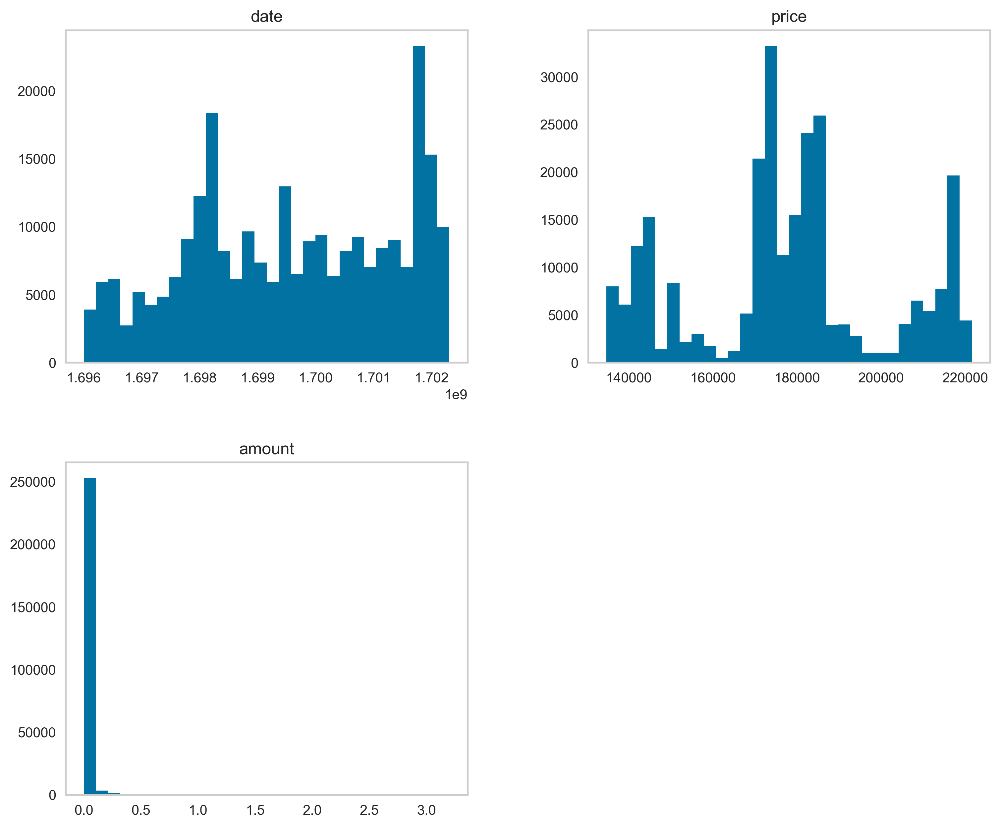

In [13]:
btc_trades_df.hist(bins = 30, figsize = (12,10), grid = False)
plt.show()

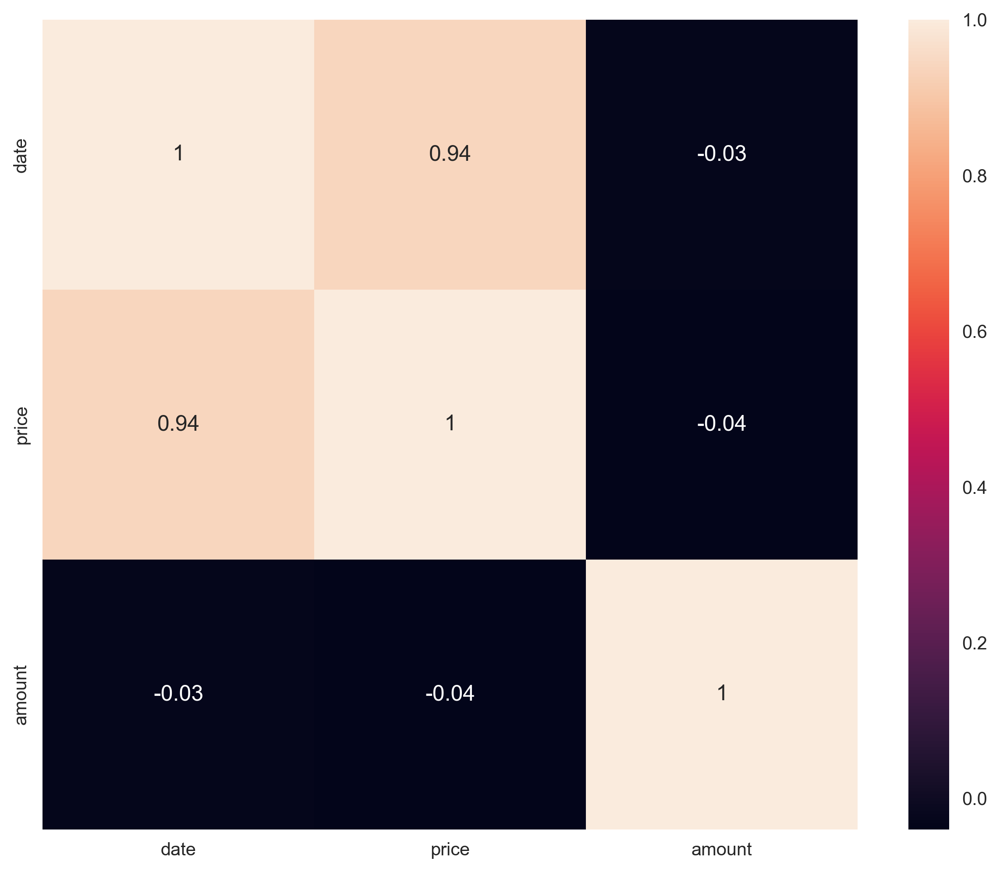

In [14]:
plt.figure(figsize=(10, 8))
sns.heatmap(btc_trades_df.corr().round(decimals=2), annot=True)
plt.show()

In [15]:
# plot_kws = {'scatter_kws': {'s': 2}, 'line_kws': {'color': 'red'}}
# sns.pairplot(btc_trades_df, kind='reg', vars=btc_trades_df['price'], plot_kws=plot_kws)
# plt.show()

## Model

In [16]:
cluster = setup(btc_trades_df, session_id=7652, index=False, normalize=True, ignore_features=["tid", "date"], use_gpu=True)

,Description,Value
0,Session id,7652
1,Original data shape,"(258000, 4)"
2,Transformed data shape,"(258000, 3)"
3,Ignore features,2
4,Ordinal features,1
5,Numeric features,2
6,Categorical features,1
7,Preprocess,True
8,Imputation type,simple
9,Numeric imputation,mean


In [17]:
kmeans = create_model('kmeans')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.5382,173929.0741,0.7372,0,0,0


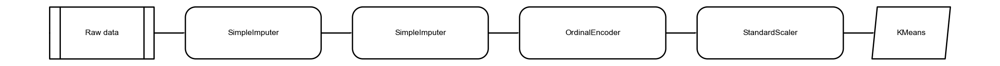

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [18]:
evaluate_model(kmeans)

In [19]:
print(kmeans)

KMeans(n_clusters=4, random_state=7652)


In [20]:
plot_model(kmeans, 'elbow', save=True)

'Elbow Plot.png'

In [21]:
plot_model(kmeans, save=True)

In [ ]:
plot_model(kmeans, plot='silhouette', save=True)

In [ ]:
plot_model(model, plot='distribution', save=True)

In [ ]:
models()

In [ ]:
kmeans2 = create_model('kmeans', num_clusters=5)

In [ ]:
plot_model(kmeans2)

In [ ]:
plot_model(kmeans2, plot='silhouette', save=True)

In [ ]:
plot_model(kmeans2, plot='distribution')

In [ ]:
meanshift = create_model('meanshift', num_clusters=4)

In [ ]:
print(meanshift)